In [34]:
%matplotlib inline
from __future__ import print_function, unicode_literals
import sys, os
import datetime as dt
import seaborn as sns
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
from functools import partial

In [35]:
from pygaarst import raster
import pandas as pd
import geopandas as gp
from fiona.crs import from_string
import shapely.ops
from shapely.geometry import Point, box
from matplotlib.collections import PatchCollection
from descartes import PolygonPatch

In [3]:
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes, mark_inset

In [4]:
sys.path.append('../firedetection/')
import landsat8fire as lfire

In [5]:
sns.set(rc={'image.cmap': 'gist_heat'})
sns.set(rc={'image.cmap': 'bone'})

sns.set_context("poster")

myfontsize = 20
font = {'family' : 'Calibri',
        'weight': 'bold',
        'size'   : myfontsize}
matplotlib.rc('font', **font)
matplotlib.axes.rcParams['axes.labelsize']=myfontsize-4
matplotlib.axes.rcParams['axes.titlesize']=myfontsize
cmap1 =  matplotlib.colors.ListedColormap(sns.xkcd_palette(['white', 'red']))
cmap2 =  matplotlib.colors.ListedColormap(sns.xkcd_palette(['white', 'neon green']))
cmap3 =  matplotlib.colors.ListedColormap(sns.xkcd_palette(['white', 'orange']))

In [8]:
gisdir = "/Volumes/SCIENCE_mobile_Mac/Fire/DATA_BY_PROJECT/2015VIIRSMODIS/10_intermediate_products/"
newviirspolydf = gp.GeoDataFrame.from_file(os.path.join(gisdir, 'EAGLEviirsspoly.shp'))

DEBUG:Fiona:Got coordinate system
DEBUG:Fiona:Index: 0


In [9]:
landsatpath = '/Volumes/SCIENCE_mobile_Mac/Fire/DATA_BY_PROJECT/2015VIIRSMODIS/Landsat/L8 OLI_TIRS Eagle/'
lsscene = 'LC8065014_15_2015147_clip'
landsat = raster.Landsatscene(os.path.join(landsatpath, lsscene))

In [15]:
landsat.meta['PRODUCT_METADATA']['DATE_ACQUIRED'], landsat.meta['PRODUCT_METADATA']['SCENE_CENTER_TIME']

(datetime.date(2015, 5, 27), datetime.time(20, 47, 22, 205191))

In [10]:
productdir = '/Volumes/SCIENCE_mobile_Mac/Fire/DATA_BY_PROJECT/2015VIIRSMODIS/rasterout/'

In [11]:
rho7 = landsat.band7.reflectance
rho6 = landsat.band6.reflectance
rho5 = landsat.band5.reflectance
rho1 = landsat.band1.reflectance

In [12]:
xmax = landsat.band7.ncol
ymax = landsat.band7.nrow

In [13]:
allfire, highfire, anomfire, lowfire = lfire.get_l8fire(landsat)

In [14]:
allfire_masked = np.ma.masked_where(
        ~allfire, np.ones((ymax, xmax)))
highfire_masked = np.ma.masked_where(
        ~highfire, np.ones((ymax, xmax)))

In [14]:
print(sum(sum(lowfire)))
print(sum(sum(allfire)))

91
274


## Load official VIIRS I-band product

In [18]:
wsfirehotspots = "/Volumes/SCIENCE_mobile_Mac/Fire/DATA_BY_PROJECT/2015VIIRSMODIS/VIIRS_I_WS_NASA/Alaska/fires.2015147.2042.txt"
inputframe = pd.read_csv(wsfirehotspots)
inputframe.columns = [colname.strip() for colname in inputframe.columns]

In [19]:
inputframe.head()

,VIIRS_Granule,Scan_Time,Lon,Lat,Sample,Line,BT_I4(K),BT_I5(K),Confidence,Period,FRP
0,2.015147e+06,20150527_20:42:00,-115.32615,53.42086,2480,13,327.6,299.9,low,day,5.13
1,2.015147e+06,20150527_20:42:00,-115.32726,53.42437,2480,14,343.1,301.4,nominal,day,8.40
2,2.015147e+06,20150527_20:42:01,-103.86549,54.30882,849,52,329.8,294.0,nominal,day,3.21
3,2.015147e+06,20150527_20:42:01,-103.92857,54.30767,859,52,332.9,292.1,nominal,day,6.21
4,2.015147e+06,20150527_20:42:01,-103.92260,54.31337,858,53,367.0,295.3,nominal,day,6.21


## Test plots of Landsat bands

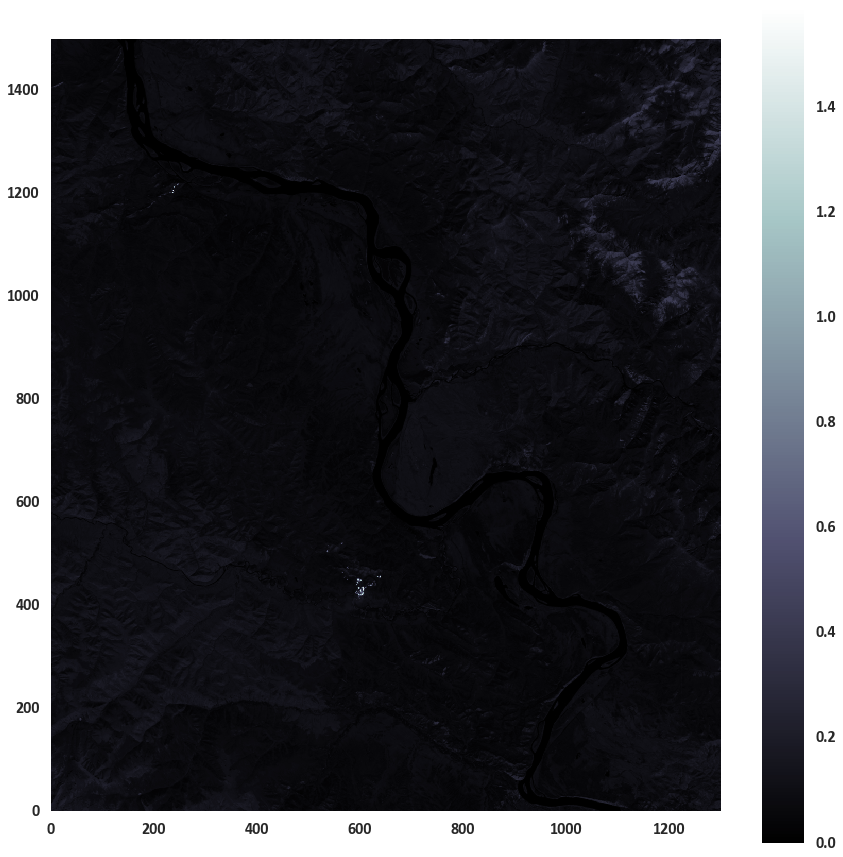

In [13]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(rho7))
cbar = fig1.colorbar(dataplot)

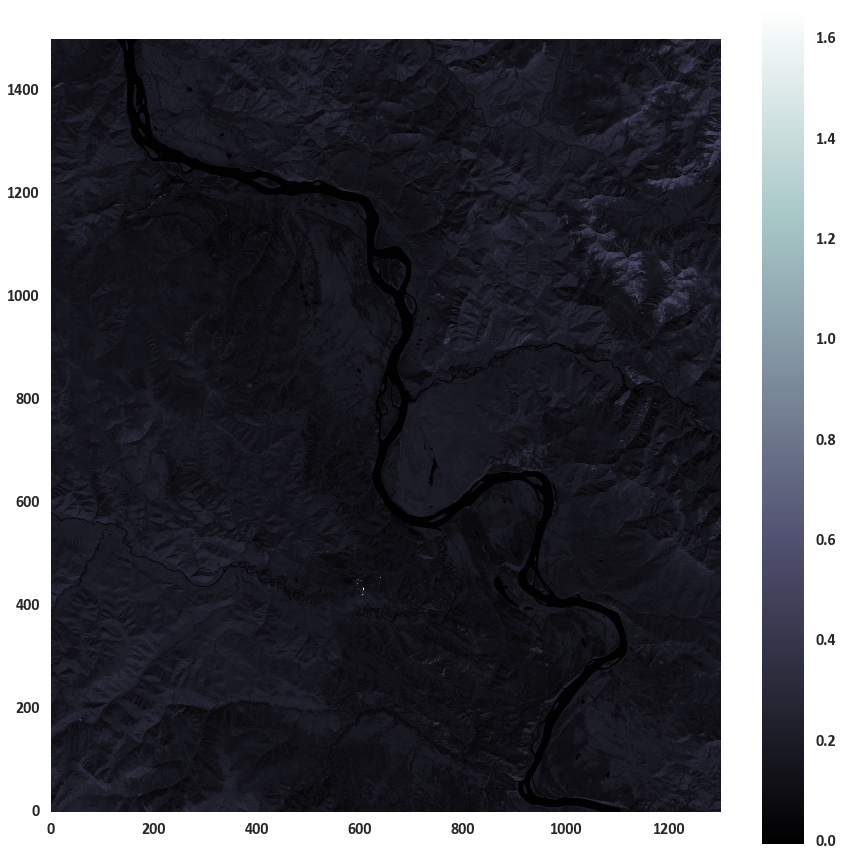

In [15]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(rho6))
cbar = fig1.colorbar(dataplot)

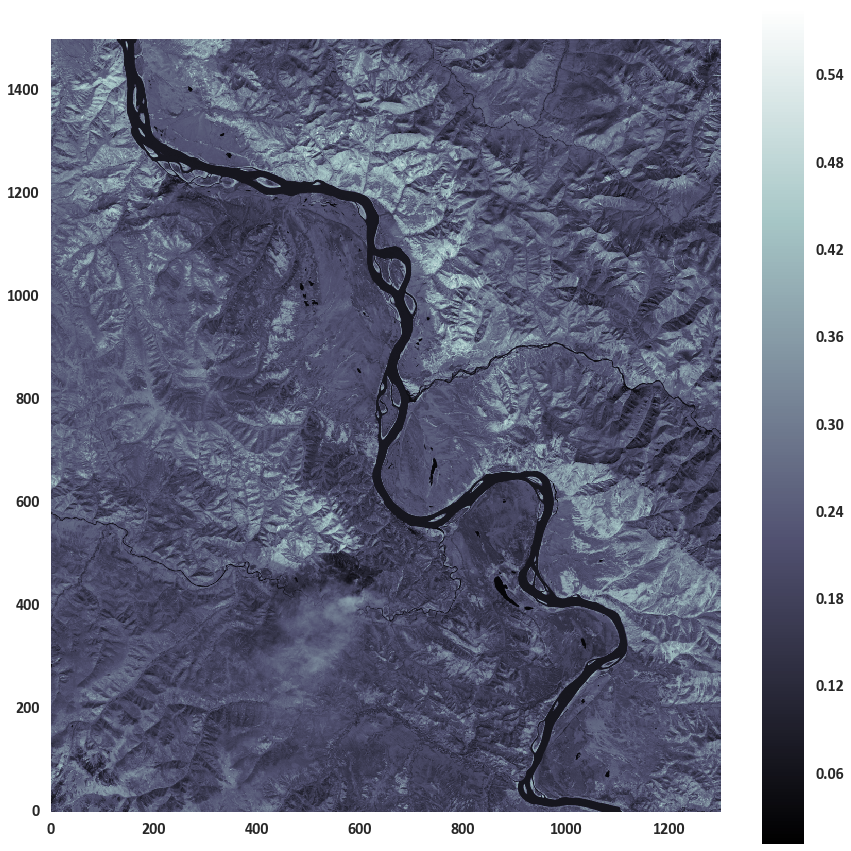

In [16]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(rho5))
cbar = fig1.colorbar(dataplot)

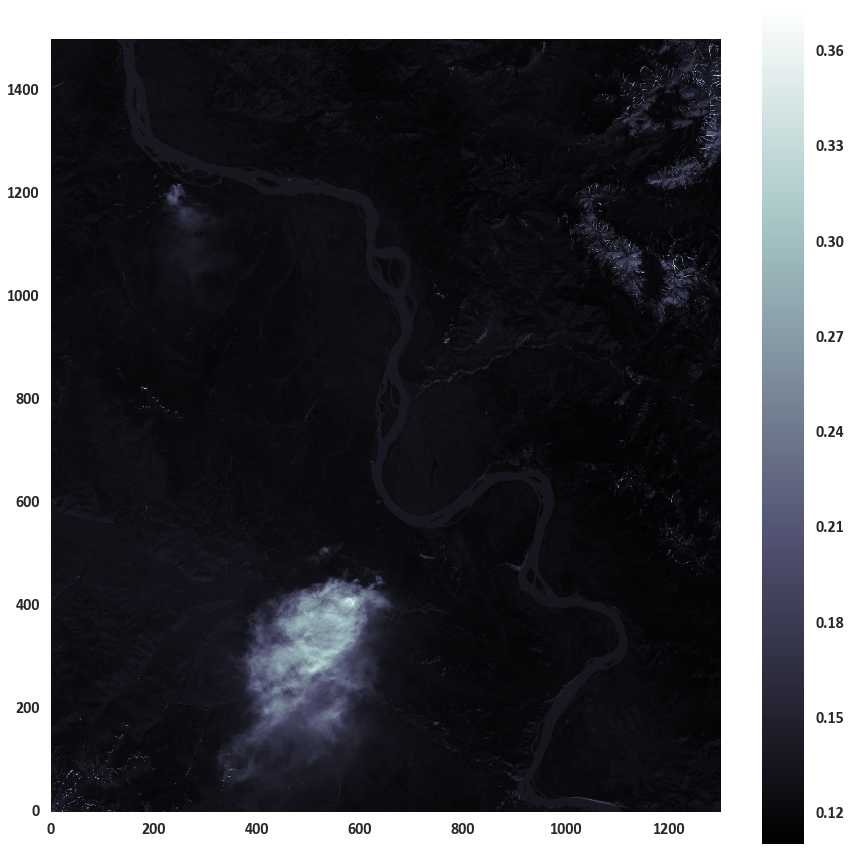

In [17]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(rho1))
cbar = fig1.colorbar(dataplot)

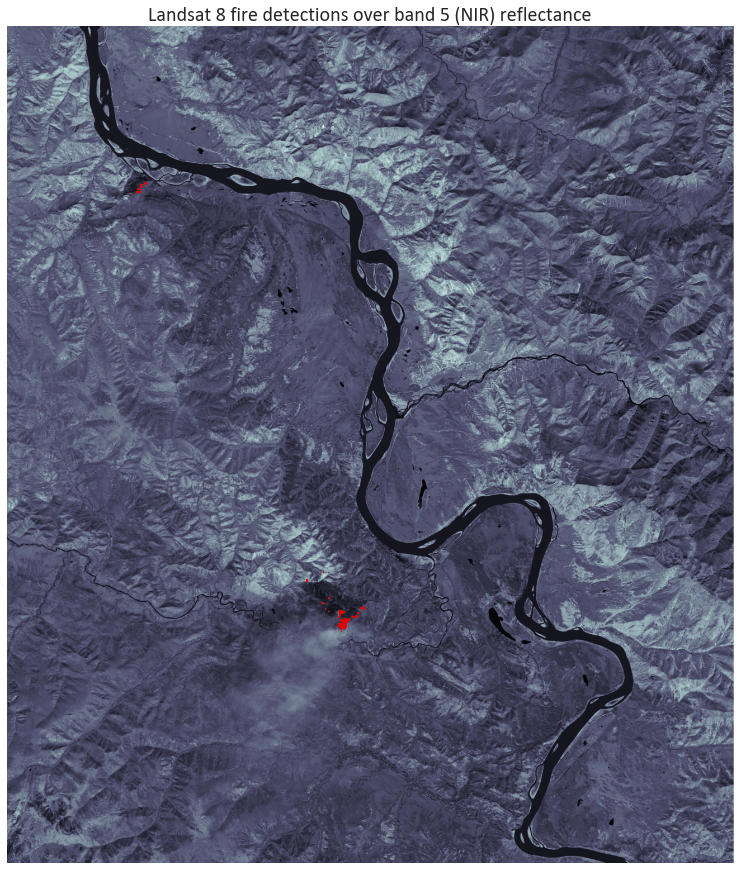

In [22]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.set_title("Landsat 8 fire detections over band 5 (NIR) reflectance")
dataplot = ax1.imshow(np.flipud(rho5))
maskplot1 = ax1.pcolormesh(np.flipud(allfire_masked), cmap=cmap1, vmin=0, vmax=1)

In [23]:
outfn = 'eagle_landsatB5_firemask2.png'
#fig1.savefig(os.path.join(productdir, outfn), dpi=200, bb_inches='tight')
fig1.savefig(os.path.join(productdir, outfn))

In [24]:
landsat.meta['PRODUCT_METADATA']['DATE_ACQUIRED'], landsat.meta['PRODUCT_METADATA']['SCENE_CENTER_TIME']

(datetime.date(2015, 5, 27), datetime.time(20, 47, 22, 205191))

In [28]:
crs = from_string(landsat.band7.proj4)
samplerecords = newviirspolydf[
    (newviirspolydf['DATE'] == '2015-05-27')
    & (newviirspolydf['GMT'] == '2045')
    & (newviirspolydf['LAT'] < 65.2)
    & (newviirspolydf['LAT'] > 64.8)]
firepolygons_h = samplerecords[(samplerecords['Type'] != 'L')]['geometry'].to_crs(crs)
firepolygons_l = samplerecords[(samplerecords['Type'] == 'L')]['geometry'].to_crs(crs)

In [26]:
samplerecords

,AscNode,Bands,DATE,GMT,LAT,LON,Platform,SatAzimuth,Sensor,SolZenithA,TB4,TB5,Type,geometry
22,Y,I-Bands,2015-05-27,2045,64.891541,-141.394470,NPP,57.365707,VIIRS,43.959435,367.000000,305.033325,A,"POLYGON ((-141.4007261452389 64.8922845247406,..."
23,Y,I-Bands,2015-05-27,2045,64.895042,-141.399628,NPP,57.407768,VIIRS,43.963318,367.000000,297.118286,A,POLYGON ((-141.4058454682324 64.89579404461499...
24,Y,I-Bands,2015-05-27,2045,64.891541,-141.394470,NPP,57.365707,VIIRS,43.959435,367.000000,305.033325,H,"POLYGON ((-141.4007261452389 64.8922845247406,..."
25,Y,I-Bands,2015-05-27,2045,64.901588,-141.375641,NPP,57.430008,VIIRS,43.967560,324.771973,292.902771,H,POLYGON ((-141.3819273188675 64.90232099449148...
26,Y,I-Bands,2015-05-27,2045,64.897125,-141.391998,NPP,57.414856,VIIRS,43.964668,341.997559,293.710083,H,POLYGON ((-141.3981397775138 64.89789593963725...
27,Y,I-Bands,2015-05-27,2045,64.895042,-141.399628,NPP,57.407768,VIIRS,43.963318,367.000000,297.118286,H,POLYGON ((-141.4058454682324 64.89579404461499...
28,Y,I-Bands,2015-05-27,2045,64.900833,-141.396362,NPP,57.457626,VIIRS,43.968685,339.619568,293.983856,H,POLYGON ((-141.4024961611093 64.90160763974907...
29,Y,I-Bands,2015-05-27,2045,64.898666,-141.404282,NPP,57.450222,VIIRS,43.967285,340.966309,294.071594,H,POLYGON ((-141.4104307309995 64.89944089233927...
30,Y,I-Bands,2015-05-27,2045,65.105873,-141.625717,NPP,57.387371,VIIRS,44.188400,326.989746,290.301880,H,POLYGON ((-141.6317747217783 65.10666668740276...
31,Y,I-Bands,2015-05-27,2045,65.104073,-141.632309,NPP,57.381096,VIIRS,44.187244,335.091766,292.537720,H,POLYGON ((-141.6381223703243 65.10493480518892...


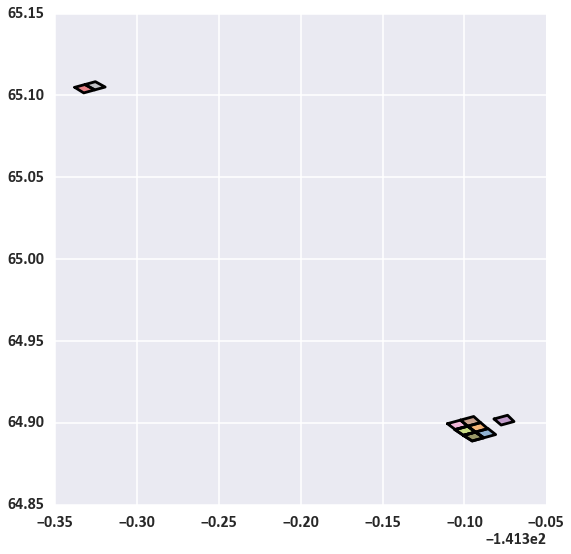

In [27]:
samplerecords['geometry'].plot()

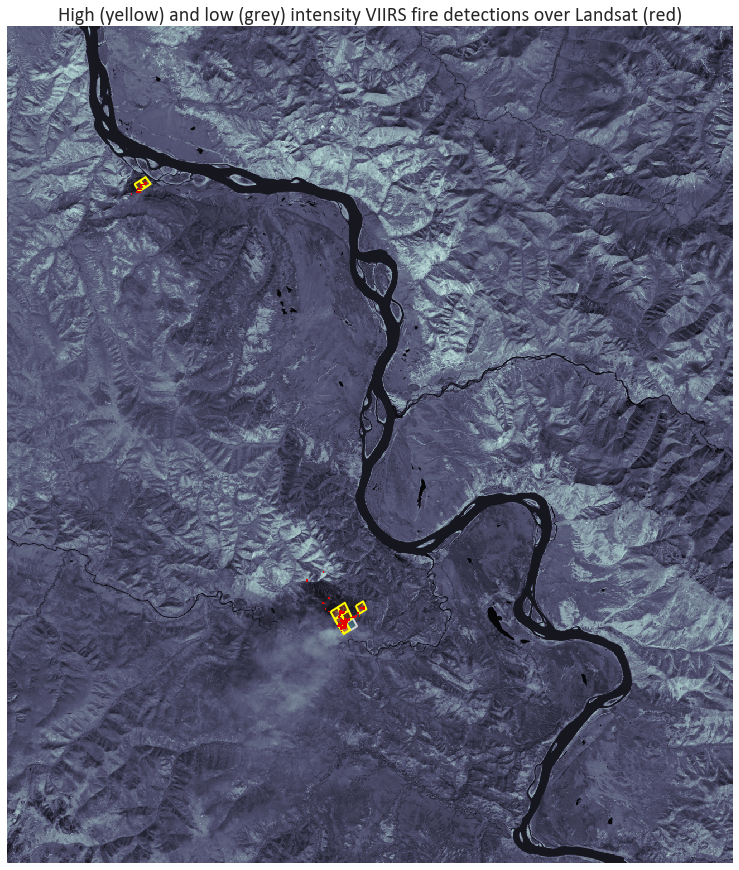

In [29]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.pcolormesh(X, Y, rho5)
patches = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=2) for poly in firepolygons_l]
ax1.add_collection(PatchCollection(patches, match_original=True))
patches = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=2) for poly in firepolygons_h]
ax1.add_collection(PatchCollection(patches, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)

In [30]:
outfn = 'eagle_landsat_firemask_footprints.png'
fig1.savefig(os.path.join(productdir, outfn), dpi=200, bb_inches='tight')

## Now with RGB background

In [55]:
rgb753scene = raster.GeoTIFF(os.path.join(landsatpath, lsscene, 'LC8065014_15_2015147_clip_fc753_8bit.tif'))
rgb753 = np.rollaxis(rgb753scene.data, 0, 3)

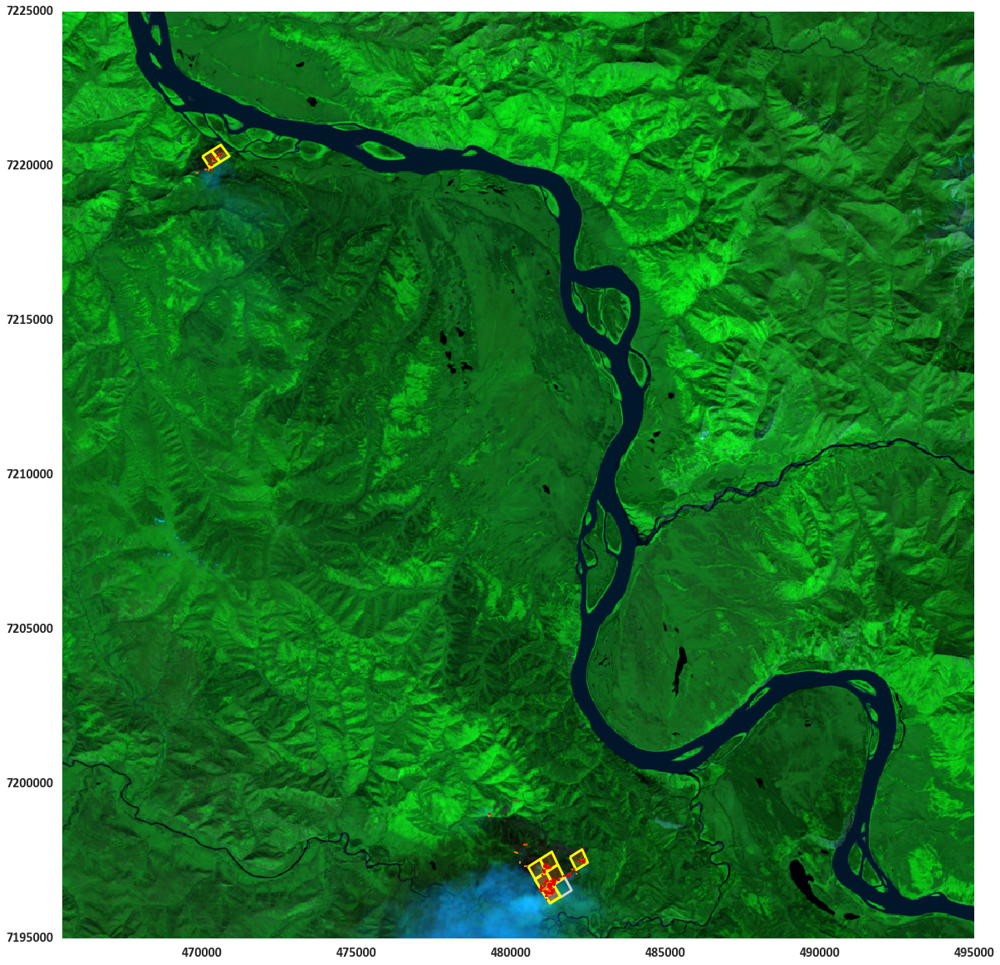

In [49]:
fig1 = plt.figure(1, figsize=(25, 20))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
ax1.set_xlim((465500, 495000))
ax1.set_ylim((7225000 , 7195000))
ax1.invert_yaxis()
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
patches = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=3) for poly in firepolygons_l]
ax1.add_collection(PatchCollection(patches, match_original=True))
patches = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=3) for poly in firepolygons_h]
ax1.add_collection(PatchCollection(patches, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap3, vmin=0, vmax=1)
maskplot2 = ax1.pcolormesh(X, Y, highfire_masked, cmap=cmap1, vmin=0, vmax=1)

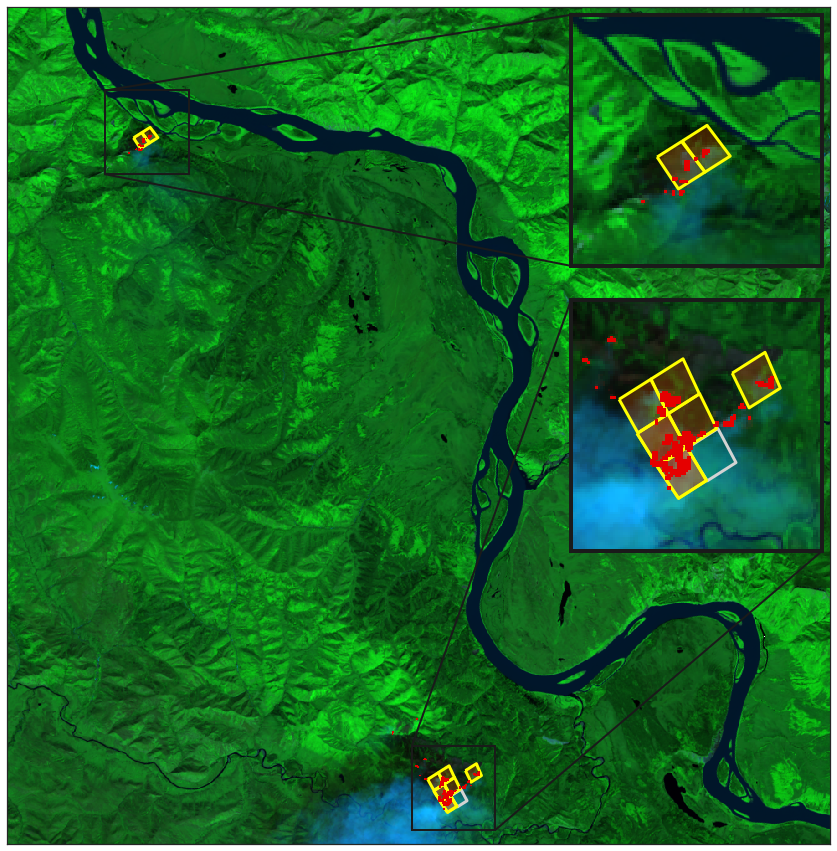

In [60]:
sns.set_style('white')

fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
ax1.set_xlim((465500, 495000))
ax1.set_ylim((7225000 , 7195000))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
patches1 = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=3) for poly in firepolygons_l]
ax1.add_collection(PatchCollection(patches1, match_original=True))
patches2 = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=3) for poly in firepolygons_h]
ax1.add_collection(PatchCollection(patches2, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)

x1, x2, y1, y2 = 480000, 483000, 7195500, 7198500
axins1 = zoomed_inset_axes(ax1, 3, loc=5)
axins1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
axins1.add_collection(PatchCollection(patches1, match_original=True))
axins1.add_collection(PatchCollection(patches2, match_original=True))
axins1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)
axins1.set_xlim((x1, x2))
axins1.set_ylim((y1, y2))
axins1.set_xticklabels([])
axins1.set_yticklabels([])
mark_inset(ax1, axins1, loc1=2, loc2=4, fc='none', ec='0.1', lw=2)

x1, x2, y1, y2 = 469000, 472000, 7219000, 7222000
axins3 = zoomed_inset_axes(ax1, 3, loc=1)
axins3.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
axins3.add_collection(PatchCollection(patches1, match_original=True))
axins3.add_collection(PatchCollection(patches2, match_original=True))
axins3.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)
axins3.set_xlim((x1, x2))
axins3.set_ylim((y1, y2))
axins3.set_xticklabels([])
axins3.set_yticklabels([])
mark_inset(ax1, axins3, loc1=2, loc2=3, fc='none', ec='0.1', lw=2)

for axis in ['top', 'bottom', 'left', 'right']:
    for ax in axins1, axins3:
        ax.spines[axis].set_color('0.1')
        ax.spines[axis].set_linewidth(4)


In [61]:
outfn = 'eagle_landsat_firemask_footprints01.png'
fig1.savefig(os.path.join(productdir, outfn), dpi=400, bb_inches='tight')

## Now with official product

There are seven official VIIRS I-band fire pixels in the study scene.

In [46]:
viirsI = inputframe[
    (inputframe['Lat'] < 65.2) 
    & (inputframe['Lat'] > 64.8) 
    & (inputframe['Lon'] < -141)]
viirsI

,VIIRS_Granule,Scan_Time,Lon,Lat,Sample,Line,BT_I4(K),BT_I5(K),Confidence,Period,FRP
337,2.015147e+06,20150527_20:46:16,-141.39447,64.89154,4463,4629,367.0,305.0,nominal,day,22.29
338,2.015147e+06,20150527_20:46:16,-141.39963,64.89504,4463,4630,367.0,297.1,nominal,day,9.41
339,2.015147e+06,20150527_20:46:16,-141.39200,64.89713,4462,4630,342.0,293.7,nominal,day,9.41
340,2.015147e+06,20150527_20:46:16,-141.39636,64.90083,4462,4631,339.6,294.0,nominal,day,9.41
341,2.015147e+06,20150527_20:46:16,-141.40428,64.89867,4463,4631,341.0,294.1,nominal,day,9.41
342,2.015147e+06,20150527_20:46:19,-141.62572,65.10587,4452,4698,327.0,290.3,nominal,day,2.92
343,2.015147e+06,20150527_20:46:19,-141.63231,65.10407,4453,4698,335.1,292.5,nominal,day,2.92


In [47]:
viirsgeo = viirsI.apply(lambda row: Point(row['Lon'], row['Lat']),
                                    axis='columns')


In [50]:
viirsIDF = gp.GeoDataFrame(viirsI, 
                           geometry=viirsgeo,
                           crs={'init': 'epsg:4326'} )
viirsIDF = viirsIDF.to_crs(crs)

In [51]:
side = 375.0
def makebox(point, a=100.0, b=None):
    if not b: 
        b=a
    return box((point.x)-a/2, point.y-b/2, point.x+a/2, point.y+b/2)

makeboxes = partial(makebox, a=side)

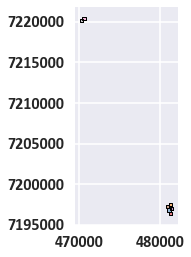

In [53]:
boxseries = gp.GeoSeries(map(makeboxes, viirsIDF.geometry.values))

boxseries.plot()

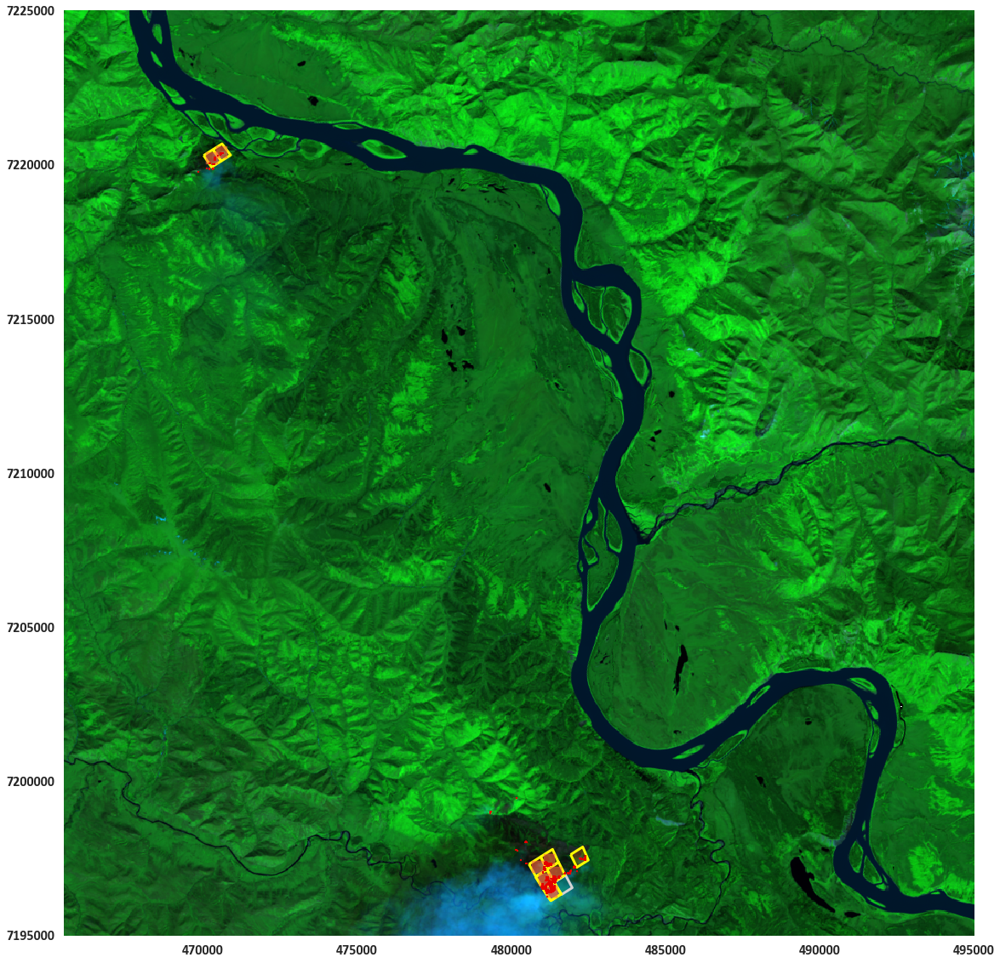

In [60]:
fig1 = plt.figure(1, figsize=(25, 20))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
ax1.set_xlim((465500, 495000))
ax1.set_ylim((7225000 , 7195000))
ax1.invert_yaxis()
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
patches = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=3) for poly in firepolygons_l]
ax1.add_collection(PatchCollection(patches, match_original=True))
patches = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=3) for poly in firepolygons_h]
ax1.add_collection(PatchCollection(patches, match_original=True))
patches = [PolygonPatch(poly, color='tomato', alpha=0.5) for poly in boxseries]
if patches:
    ax1.add_collection(PatchCollection(patches, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)


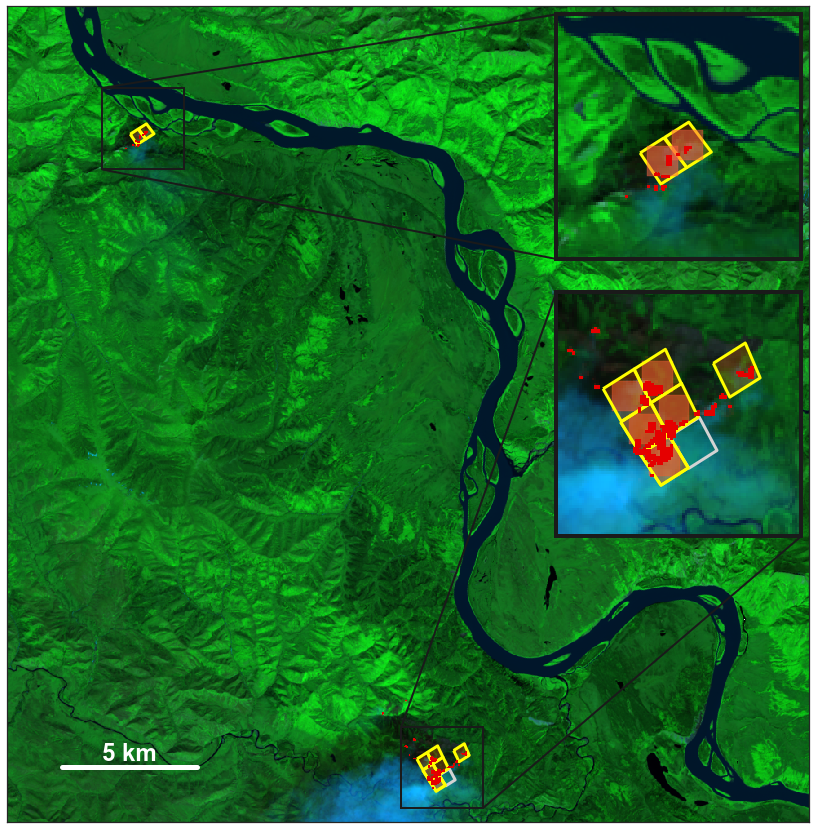

In [70]:
sns.set_style('white')

fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
ax1.set_xlim((465500, 495000))
ax1.set_ylim((7225000 , 7195000))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
#ax1.set_title("High (yellow) and low (grey) intensity VIIRS fire detections over Landsat (red)")
dataplot = ax1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
patches1 = [PolygonPatch(poly, facecolor=(0, 0.55, 0.45, 0.25), edgecolor='lightgrey', lw=3) for poly in firepolygons_l]
ax1.add_collection(PatchCollection(patches1, match_original=True))
patches2 = [PolygonPatch(poly, facecolor=(1, 0.35, 0, 0.25), edgecolor='yellow', lw=3) for poly in firepolygons_h]
ax1.add_collection(PatchCollection(patches2, match_original=True))
maskplot1 = ax1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)
#scale bar
ax1.plot([467500, 472500], [7197000, 7197000], color='w', lw=5)
ax1.text(470000, 7197500, 
         '5 km', 
          ha="center", va="center", 
          color='w', size=24)

patches3 = [PolygonPatch(poly, color='tomato', alpha=0.5) for poly in boxseries]


x1, x2, y1, y2 = 480000, 483000, 7195500, 7198500
axins1 = zoomed_inset_axes(ax1, 3, loc=5)
axins1.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
axins1.add_collection(PatchCollection(patches3, match_original=True))
axins1.add_collection(PatchCollection(patches1, match_original=True))
axins1.add_collection(PatchCollection(patches2, match_original=True))
axins1.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)
axins1.set_xlim((x1, x2))
axins1.set_ylim((y1, y2))
axins1.set_xticklabels([])
axins1.set_yticklabels([])
mark_inset(ax1, axins1, loc1=2, loc2=4, fc='none', ec='0.1', lw=2)

x1, x2, y1, y2 = 469000, 472000, 7219000, 7222000
axins3 = zoomed_inset_axes(ax1, 3, loc=1)
axins3.imshow(np.flipud(rgb753), extent=[X[0][0], X[0, -1], Y[0][0], Y[-1, 0]], interpolation='none')
axins3.add_collection(PatchCollection(patches2, match_original=True))
axins3.add_collection(PatchCollection(patches1, match_original=True))
axins3.add_collection(PatchCollection(patches3, match_original=True))
axins3.pcolormesh(X, Y, allfire_masked, cmap=cmap1, vmin=0, vmax=1)
axins3.set_xlim((x1, x2))
axins3.set_ylim((y1, y2))
axins3.set_xticklabels([])
axins3.set_yticklabels([])
mark_inset(ax1, axins3, loc1=2, loc2=3, fc='none', ec='0.1', lw=2)

for axis in ['top', 'bottom', 'left', 'right']:
    for ax in axins1, axins3:
        ax.spines[axis].set_color('0.1')
        ax.spines[axis].set_linewidth(4)


## Statistics

In [92]:
sns.set_style('darkgrid')

In [83]:
samplerecords.drop_duplicates(subset=['LAT', 'LON', 'DATE', 'GMT']).to_crs(crs)

,AscNode,Bands,DATE,GMT,LAT,LON,Platform,SatAzimuth,Sensor,SolZenithA,TB4,TB5,Type,geometry,pointcount
22,Y,I-Bands,2015-05-27,2045,64.891541,-141.394470,NPP,57.365707,VIIRS,43.959435,367.000000,305.033325,H,"POLYGON ((481027.1318393929 7196510.072509889,...",57
23,Y,I-Bands,2015-05-27,2045,64.895042,-141.399628,NPP,57.407768,VIIRS,43.963318,367.000000,297.118286,H,"POLYGON ((480787.2625459838 7196902.734493107,...",57
25,Y,I-Bands,2015-05-27,2045,64.901588,-141.375641,NPP,57.430008,VIIRS,43.967560,324.771973,292.902771,H,"POLYGON ((481923.9283325546 7197623.081051164,...",16
26,Y,I-Bands,2015-05-27,2045,64.897125,-141.391998,NPP,57.414856,VIIRS,43.964668,341.997559,293.710083,H,"POLYGON ((481153.5204095043 7197134.661999879,...",32
28,Y,I-Bands,2015-05-27,2045,64.900833,-141.396362,NPP,57.457626,VIIRS,43.968685,339.619568,293.983856,H,"POLYGON ((480949.9387916048 7197549.616194888,...",32
29,Y,I-Bands,2015-05-27,2045,64.898666,-141.404282,NPP,57.450222,VIIRS,43.967285,340.966309,294.071594,H,"POLYGON ((480572.834841336 7197310.556319009, ...",12
30,Y,I-Bands,2015-05-27,2045,65.105873,-141.625717,NPP,57.387371,VIIRS,44.188400,326.989746,290.301880,H,"POLYGON ((470326.8541778891 7220490.856619003,...",7
31,Y,I-Bands,2015-05-27,2045,65.104073,-141.632309,NPP,57.381096,VIIRS,44.187244,335.091766,292.537720,H,"POLYGON ((470026.7762649498 7220300.843769847,...",13
34,Y,I-Bands,2015-05-27,2045,64.893539,-141.387177,NPP,57.372517,VIIRS,43.960728,320.006348,291.856812,L,"POLYGON ((481375.2927838081 7196731.513524322,...",2


In [32]:
firecond1idx = (ymax - np.where(allfire)[0], np.where(allfire)[1])
firecond1idx

(array([1219, 1219, 1219, 1218, 1218, 1217, 1216, 1215, 1215, 1214, 1214,
        1213, 1213, 1212, 1212, 1208, 1208, 1207, 1207, 1207, 1203, 1203,
        1203, 1203, 1202, 1202, 1199,  522,  507,  507,  506,  505,  475,
         474,  474,  474,  466,  466,  465,  459,  458,  458,  457,  457,
         457,  457,  457,  456,  456,  456,  456,  456,  456,  455,  455,
         455,  453,  453,  452,  452,  452,  452,  451,  451,  451,  451,
         451,  451,  451,  451,  451,  451,  450,  450,  450,  450,  450,
         450,  450,  450,  449,  449,  449,  449,  449,  449,  448,  448,
         448,  448,  448,  447,  447,  447,  447,  447,  446,  446,  446,
         445,  445,  445,  444,  444,  444,  443,  443,  443,  442,  442,
         441,  441,  441,  441,  441,  441,  440,  440,  440,  440,  440,
         440,  437,  437,  437,  437,  437,  436,  436,  436,  436,  436,
         436,  436,  436,  436,  435,  435,  435,  435,  435,  435,  435,
         435,  435,  435,  434,  434, 

In [33]:
ymax

1500

In [34]:
firepoints_h = [Point(lon, lat) 
    for lon, lat in zip(landsat.band7.Lon_pxcenter[firecond1idx], landsat.band7.Lat_pxcenter[firecond1idx])]

In [72]:
samplerecords['pointcount'] = 0
for idx, record in samplerecords.iterrows():
    poly = record['geometry']
    for pt in firepoints_h:
        if pt.within(poly):
            samplerecords.loc[idx, 'pointcount'] += 1

/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [69]:
samplerecords.loc[samplerecords['Type'] == 'A', 'Type'] = 'H'

In [84]:
samplerecords = samplerecords.drop_duplicates(subset=['LAT', 'LON', 'DATE', 'GMT'])

In [85]:
samplerecords.groupby('Type').describe()

LAT         LON  SatAzimuth  SolZenithA         TB4  \
Type                                                                    
H    count   8.000000    8.000000    8.000000    8.000000    8.000000   
     mean   64.949343 -141.452551   57.411832   44.020824  342.929615   
     std     0.096111    0.109246    0.032945    0.103115   16.123000   
     min    64.891541 -141.632309   57.365707   43.959435  324.771973   
     25%    64.896605 -141.459641   57.385802   43.964331  333.066261   
     50%    64.899750 -141.397995   57.411312   43.967422  340.292938   
     75%    64.952209 -141.393852   57.435061   44.023325  348.248169   
     max    65.105873 -141.375641   57.457626   44.188400  367.000000   
L    count   1.000000    1.000000    1.000000    1.000000    1.000000   
     mean   64.893539 -141.387177   57.372517   43.960728  320.006348   
     std          NaN         NaN         NaN         NaN         NaN   
     min    64.893539 -141.387177   57.372517   43.960728  320.006348   
     25%    64.893539 -141.387177   57.372517   43.960728  320.006348   
     50%    64.893539 -141.387177   57.372517   43.960728  320.006348   
     75%    64.893539 -141.387177   57.372517   43.960728  320.006348   
     max    64.893539 -141.387177   57.372517   43.960728  320.006348   

                   TB5  pointcount  
Type                                
H    count    8.000000    8.000000  
     mean   294.957439   28.250000  
     std      4.491773   19.926651  
     min    290.301880    7.000000  
     25%    292.811508   12.750000  
     50%    293.846970   24.000000  
     75%    294.833267   38.250000  
     max    305.033325   57.000000  
L    count    1.000000    1.000000  
     mean   291.856812    2.000000  
     std           NaN         NaN  
     min    291.856812    2.000000  
     25%    291.856812    2.000000  
     50%    291.856812    2.000000  
     75%    291.856812    2.000000  
     max    291.856812    2.000000

(-2, 60)

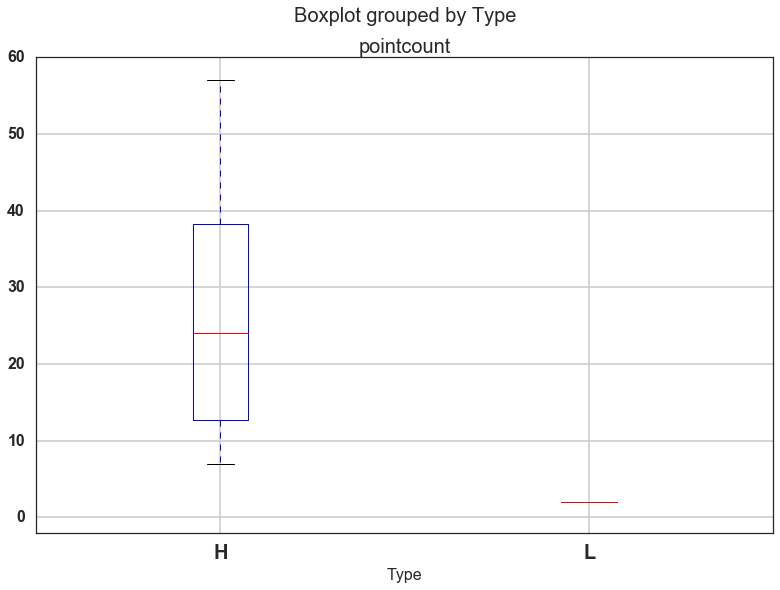

In [87]:
samplerecords[['pointcount', 'Type']].boxplot(column='pointcount', by='Type', sym='k.')
ax = plt.gca()
ax.set_ylim(-2, 60)


In [41]:
myfig = plt.gcf()
outfn = 'eagle_landsat_firematch_boxplot.png'
myfig.savefig(os.path.join(productdir, outfn), dpi=200, bb_inches='tight')

(-2, 67)

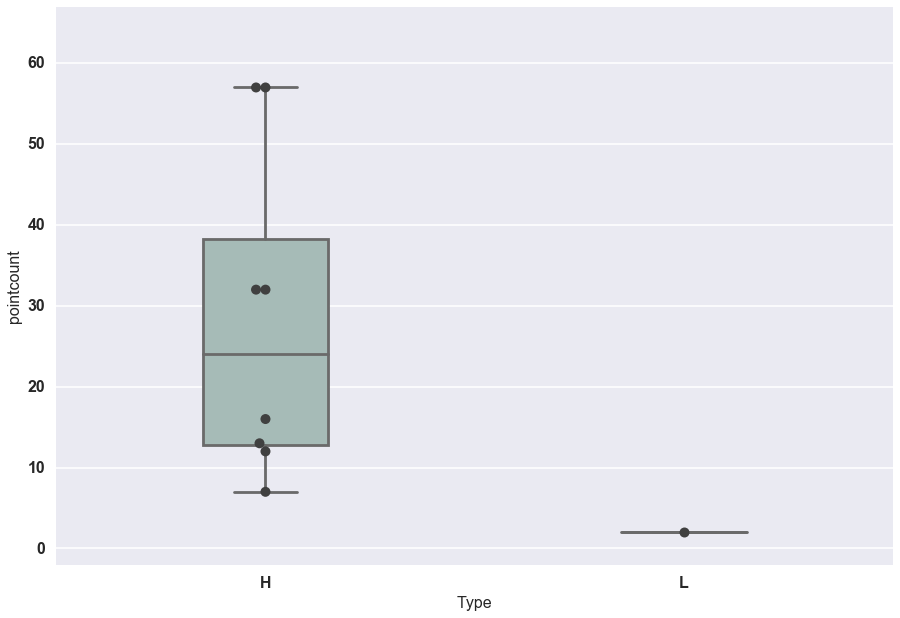

In [95]:
fig2 = plt.figure(1, figsize=(15, 10))
ax2 = fig2.add_subplot(111)
sns.boxplot(x='Type', y='pointcount', data=samplerecords,
    palette="Set3", saturation=0.3, width=.3, ax=ax2)
sns.swarmplot(
    x='Type', y='pointcount', data=samplerecords, color=".25", size=10, ax=ax2)
ax2.set_ylim(-2, 67)

In [97]:
outfn = 'eagle_landsat_firematch_boxplot.png'
fig2.savefig(os.path.join(productdir, outfn), dpi=200, bb_inches='tight')

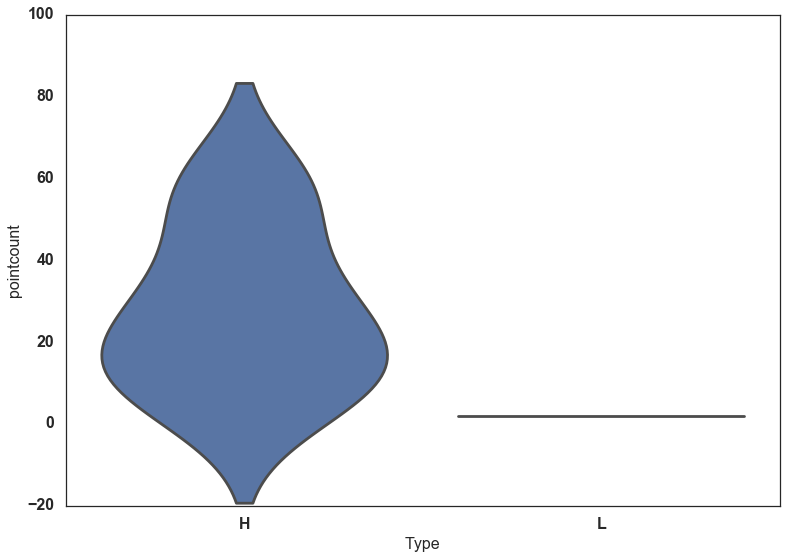

In [90]:
ax = sns.violinplot(x='Type', y='pointcount', data=samplerecords, inner=None)

### NBR investigation

In [58]:
NBR = landsat.NBR

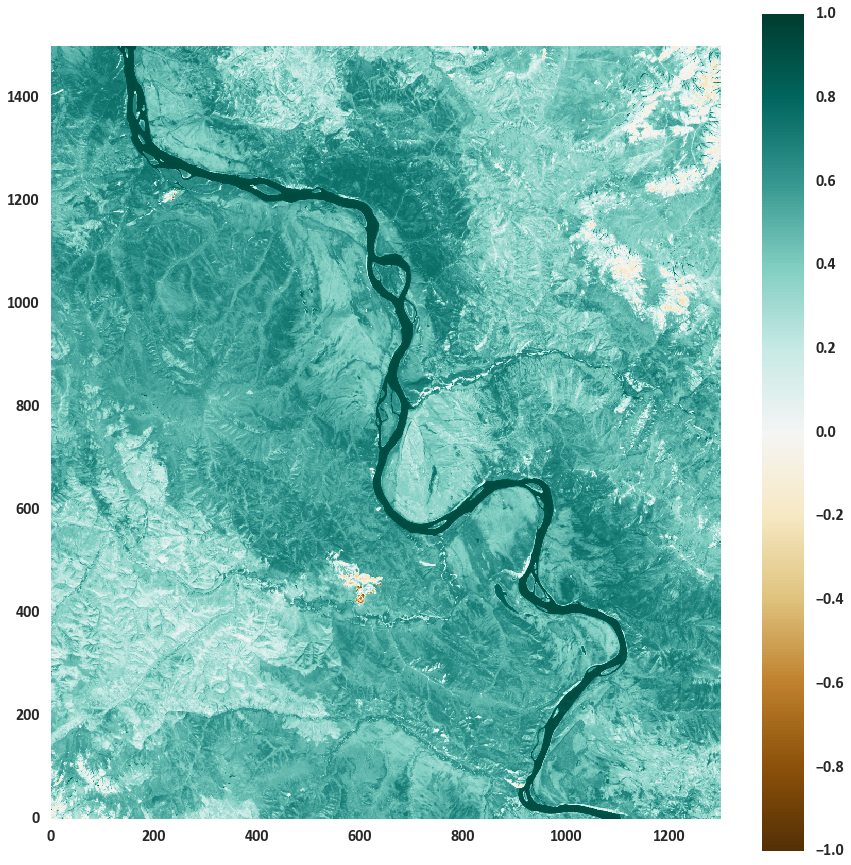

In [59]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(NBR), cmap='BrBG', vmin=-1., vmax=1.)
cbar = fig1.colorbar(dataplot)

In [60]:
scene_before = 'LC80660142015138LGN00'
scene_after = 'LC80660142015170LGN00'
landsat_before = raster.Landsatscene(os.path.join(landsatpath, scene_before))
landsat_after = raster.Landsatscene(os.path.join(landsatpath, scene_after))
landsat_before.infix = '_clip'
landsat_after.infix = '_clip'

In [61]:
NBR_before = landsat_before.NBR
NBR_after = landsat_after.NBR

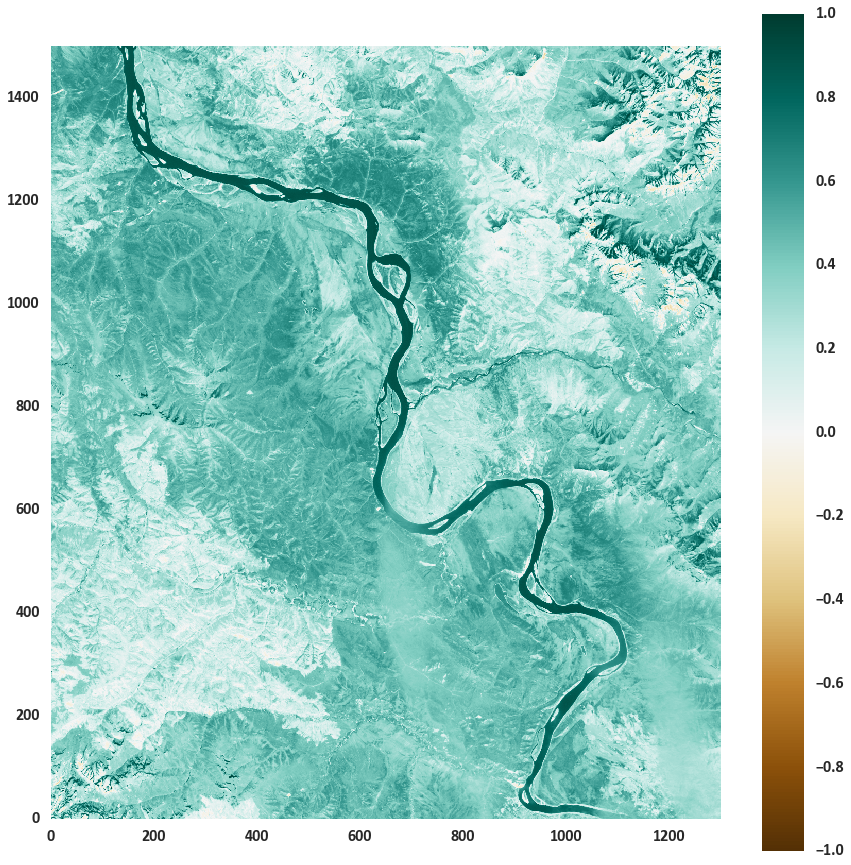

In [62]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(NBR_before), cmap='BrBG', vmin=-1., vmax=1.)
cbar = fig1.colorbar(dataplot)

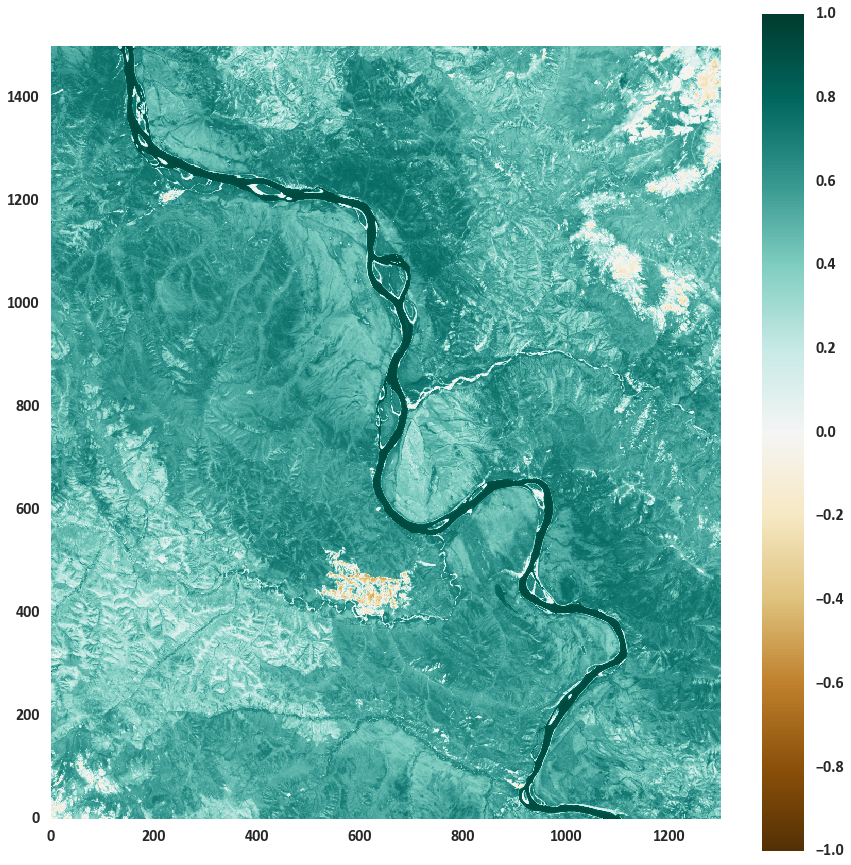

In [63]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(NBR_after), cmap='BrBG', vmin=-1., vmax=1.)
cbar = fig1.colorbar(dataplot)

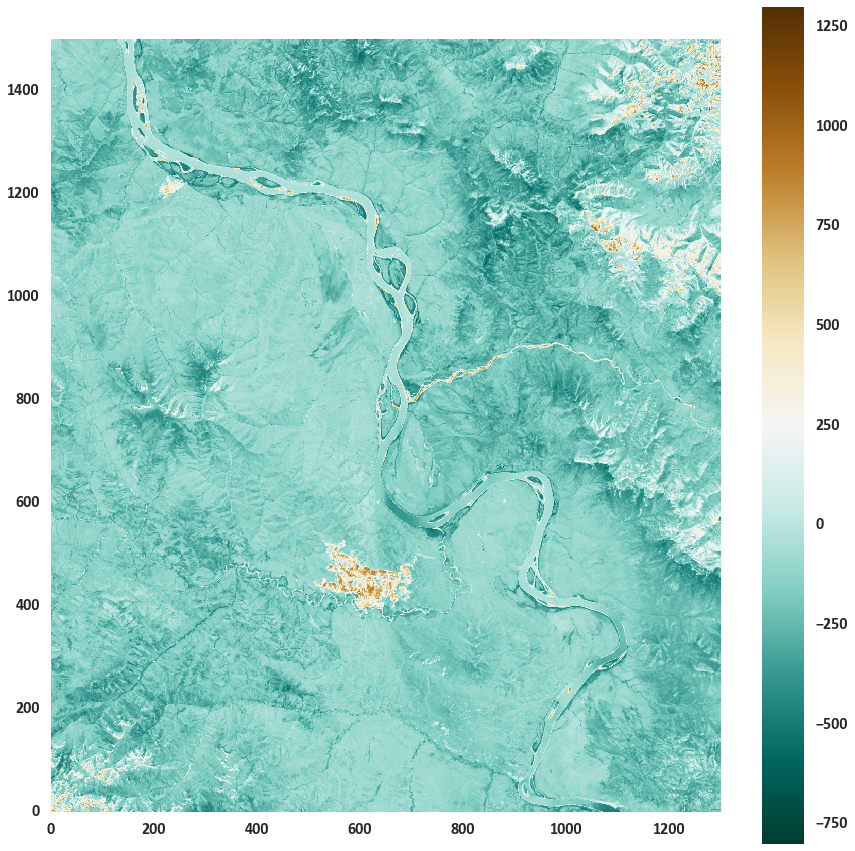

In [64]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
ax1.set_xlim((0, xmax))
ax1.set_ylim((0, ymax))
dataplot = ax1.pcolormesh(np.flipud(NBR_before - NBR_after)*1000, cmap='BrBG_r', vmin=-800., vmax=1300.)
cbar = fig1.colorbar(dataplot)

In [65]:
crs = from_string(landsat_after.band7.proj4)
firepolygons = newviirspolydf['geometry'].to_crs(crs)

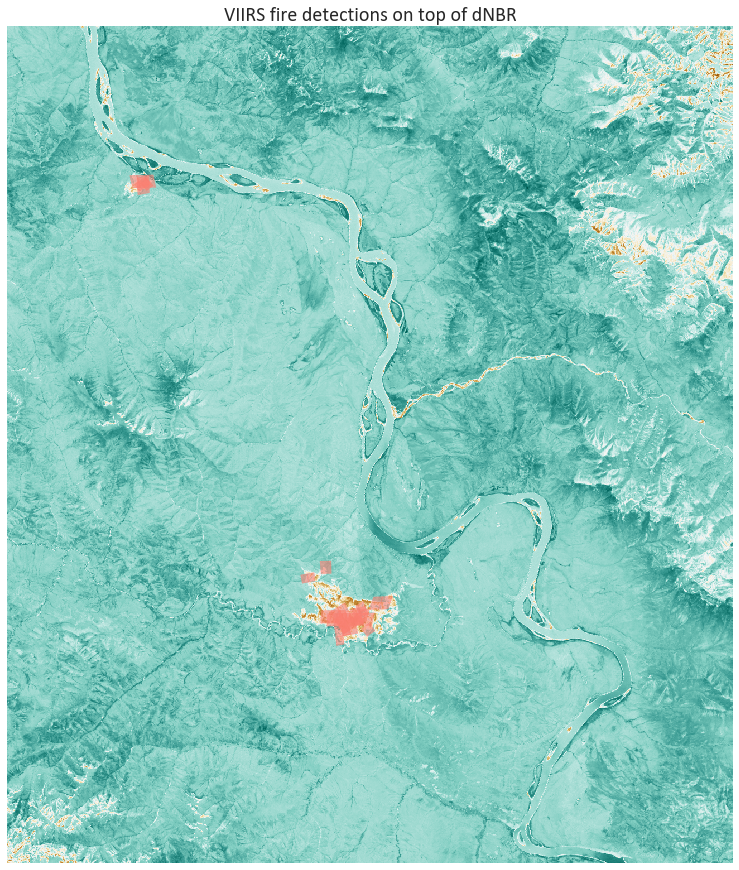

In [66]:
fig1 = plt.figure(1, figsize=(15, 15))
ax1 = fig1.add_subplot(111)
ax1.set_aspect('equal')
X, Y =  landsat_after.band5._XY
Y = np.flipud(Y)
ax1.set_xlim((X[0][0], X[0, -1]))
ax1.set_ylim((Y[0][0], Y[-1, 0]))
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.invert_yaxis()
ax1.set_title("VIIRS fire detections on top of dNBR")
dataplot = ax1.pcolormesh(X, Y, (NBR_before - NBR_after)*1000, cmap='BrBG_r', vmin=-800., vmax=1300.)
patches = [PolygonPatch(poly, color='salmon', alpha=0.6) for poly in firepolygons]
ax1.add_collection(PatchCollection(patches, match_original=True))